## What are autoencoders?
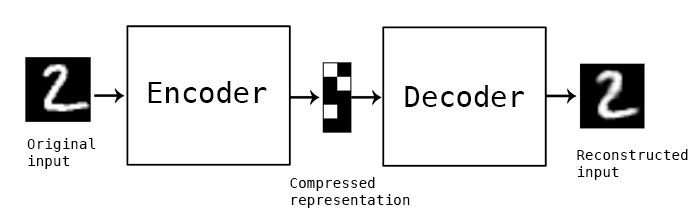
""L'autoencoding" è un algoritmo di compressione dati in cui le funzioni di compressione e decompressione sono specifiche dei dati, cioè progettate per trattare un particolare tipo di dati. A differenza di algoritmi di compressione più generici, come ad esempio MPEG-2 Audio Layer III (MP3), gli autoencoder sono adattati solo a dati simili a quelli su cui sono stati addestrati. Ad esempio, un autoencoder addestrato su immagini di volti sarà meno efficace nel comprimere immagini di alberi, poiché le sue capacità di compressione saranno concentrate sulle caratteristiche specifiche dei volti.

Un altro aspetto degli autoencoder è la loro natura con perdita, il che significa che la decompressione dei dati compressi comporterà una perdita di qualità rispetto agli input originali. Questo è simile al concetto di compressione MP3 o JPEG, dove la qualità audio o visiva può essere compromessa per ridurre le dimensioni del file.

Una caratteristica interessante degli autoencoder è la capacità di apprendere automaticamente da esempi di dati. Ciò significa che non è necessario progettare manualmente le funzioni di compressione e decompressione, ma il modello può essere addestrato su dati appropriati per ottimizzare le sue prestazioni su un tipo specifico di input.

Per costruire un autoencoder, sono necessarie tre componenti principali: una funzione di codifica, una funzione di decodifica e una funzione di calcolo della perdita tra la rappresentazione compressa dei dati e la rappresentazione decompressa. La codifica e la decodifica sono spesso implementate come reti neurali, che sono modelli matematici in grado di apprendere automaticamente le regole per comprimere e decomprimere i dati. L'addestramento dell'autoencoder avviene attraverso l'ottimizzazione delle reti neurali tramite algoritmi come la discesa del gradiente stocastico, in modo da ridurre al minimo la perdita di informazioni durante la decompressione.

L'utilizzo degli autoencoder è una tecnica potente per la compressione e la ricostruzione di dati, e la loro implementazione pratica non richiede una comprensione approfondita dei dettagli matematici e algoritmici coinvolti."

In [4]:
import google.colab #to import the google colab
from google.colab import drive #import the drive from google colab
drive.mount('/content/gdrive') #mounting the drive with the colab

Mounted at /content/gdrive


##Lets first import some important libraries which help some data mining and data handling

In [5]:
import os                       #import the py.os library to operate on systems files
import cv2                      #to impoprt open CV is the imaging library used to do operation on images and to handle image dataset
import pandas as pd             #import pandas for  data manipulation and analysis.
import numpy as np              #import numpy pyhton libbrary for  data manipulation and analysis.
import matplotlib.pyplot as plt #matplotlib is the plotting library to import the data
import seaborn as sns           #import seaborn which is sata visualisation library
import random                   #rimport andom module This allows you to then just call random() directly



## Dataset
It is pancreatic cancer dataset which contain MRI SCAN of multiple patients in the form of png images
It is a 3 scale image dataset which is obtain by the slicing of of 3D MRI scan and after converting it from the diacom image to png images, these are the high pixel 512*512 size images

###Start with Loading our dataset

In [6]:
train_dataset = '/content/gdrive/My Drive/Dataset/train'
test_dataset = '/content/gdrive/My Drive/Dataset/test'

In [7]:
train = os.listdir(train_dataset) #storing train dataset into train variable
test = os.listdir(test_dataset)   #storing the list of test dataset into test variable
import sklearn.model_selection as model_selection  #import the model_selection from sklearn to split the train and test,
                                                   # with train_test-split function
X_train, X_test, = model_selection.train_test_split(train, train_size=0.90,  random_state=101)



In [8]:
len(X_train) #length function ro give the number of dataset we have

196

In [9]:
len(X_test)  #length function to give number of test dataset we have

22

In [10]:
print(X_train)

['000192.png', '000001.png', '000031.png', '000019.png', '000198.png', '000078.png', '000021.png', '000047.png', '000120.png', '000114.png', '000154.png', '000003.png', '000142.png', '000059.png', '000045.png', '000101.png', '000056.png', '000048.png', '000054.png', '000013.png', '000129.png', '000117.png', '000041.png', '000121.png', '000176.png', '000133.png', '000197.png', '000201.png', '000164.png', '000118.png', '000177.png', '000171.png', '000134.png', '000213.png', '000156.png', '000024.png', '000116.png', '000111.png', '000184.png', '000145.png', '000023.png', '000074.png', '000206.png', '000139.png', '000107.png', '000214.png', '000155.png', '000069.png', '000216.png', '000005.png', '000032.png', '000150.png', '000161.png', '000087.png', '000040.png', '000210.png', '000098.png', '000020.png', '000127.png', '000015.png', '000071.png', '000091.png', '000140.png', '000004.png', '000082.png', '000205.png', '000049.png', '000052.png', '000108.png', '000044.png', '000181.png', '0001

In [11]:
print(X_test)


['000053.png', '000143.png', '000094.png', '000165.png', '000137.png', '000075.png', '000081.png', '000026.png', '000042.png', '000166.png', '000147.png', '000173.png', '000086.png', '000128.png', '000196.png', '000186.png', '000030.png', '000067.png', '000037.png', '000011.png', '000152.png', '000036.png']


In [12]:
img_training_dataset=[]  #declairing  the img_training_dataset array to stor each photo on continous
                         # so that manupulation will be easy
for i in X_train:
 img_training_dataset.append(cv2.imread(os.path.join(train_dataset,i),0))  # appending each images into above list


In [13]:
img_testing_dataset=[]
for i in X_test:
  img_testing_dataset.append(cv2.imread(os.path.join(test_dataset,i),0))

# Now we will gonna do the Normalization
Similarly, the goal of normalization is to change the values of numeric columns in the dataset to a common scale,

In [14]:
img_training_dataset = np.array(img_training_dataset)  #converting the img_training dataset into numpy array
img_testing_dataset = np.array(img_testing_dataset)    #converting the imgtesting dataset into numpy array
img_training_dataset = img_training_dataset/255        #rescalling the value of numpy array img_training_dataset
img_testing_dataset = img_testing_dataset/255          #rescalling the value of numpy array img_testing_dataset

## LET VISUALIZE OUR  DATASET


In [15]:
print(img_training_dataset.shape) #In the given tuble 1st  value shows number of images and
                                  #two is the size of the images

print(img_testing_dataset.shape) #

(196, 512, 512)
(22, 512, 512)


###We will now see the 1st image of the dataset
Note : this is the RBG (3scale image dataset)

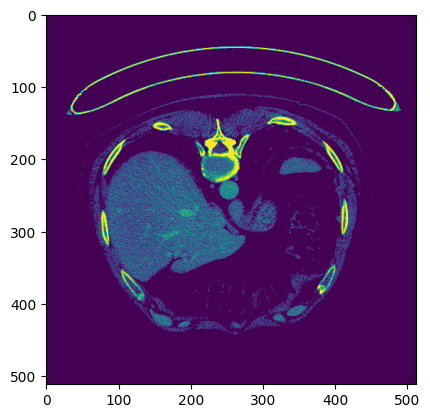

In [16]:

plt.imshow(img_testing_dataset[0]) #this is and rbg image with channel 3
                                   #and if you dont specify the cmap it will by defualt give you the rgb image

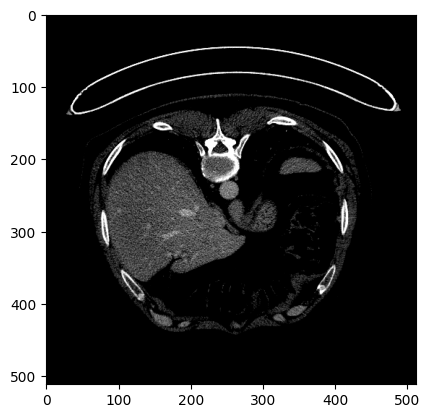

In [17]:
plt.imshow(img_testing_dataset[0], cmap='gray') #after specifying the cmap as gray we will get a grayscale images

## Let's look into more grayscale images

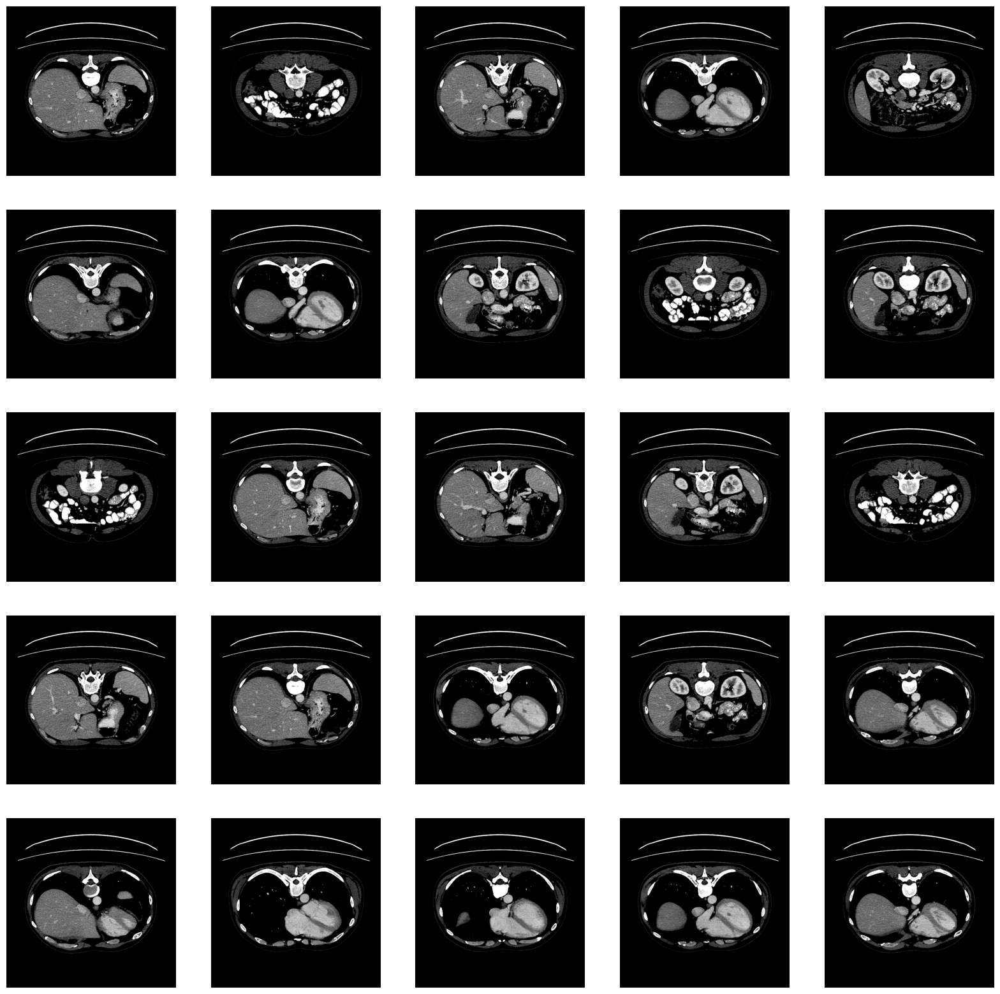

In [18]:
l_grid=5
w_grid=5
fig,axes=plt.subplots(l_grid,w_grid,figsize=(20,20))
axes=axes.ravel()
for i in range(l_grid*w_grid):
  index=np.random.randint(0,len(img_training_dataset))
  axes[i].imshow(img_training_dataset[index],cmap='gray')
  axes[i].set_axis_off()

In [19]:
img_training_dataset #looking the numpy array of our img_training_dataset

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [20]:
img_testing_dataset  #looking numpy array of our img_testing_dataset

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [21]:
img_testing_dataset.shape  #shape of our img_testing_dataset


(22, 512, 512)

In [22]:
img_training_dataset.shape #shape of ouor img_trainging_dataset

(196, 512, 512)


#Now lets put some noise

In [23]:
noise_factor = 0.3                         #noise factor which we appply on every image of our dataset
noise_training_dataset = []                #declairing the noise_training_dataset array
for img in img_training_dataset:           #loop for itterate on each images of img_training_dataset
  noisy_image = img + noise_factor*np.random.randn(*img.shape) #generating the noise_images
  noisy_image = np.clip(noisy_image, 0,1)
  noise_training_dataset.append(noisy_image)  #appending each images into our noise_training_dartaset

In [24]:
noise_factor = 0.3              #noise factor which we appply on every image of our dataset
noise_test_dataset = []         #declairing the noise_test_dataset array
for img in img_testing_dataset: #loop for itterate on each images of img_test_dataset
  noisy_image = img + noise_factor*np.random.randn(*img.shape) #generating the noise_images
  noisy_image = np.clip(noisy_image, 0,1)
  noise_test_dataset.append(noisy_image) #appending each images into our noise_training_dartaset

In [25]:
noise_training_dataset = np.array(noise_training_dataset) #converting the noise_training dataset into numpy array
noise_test_dataset= np.array(noise_test_dataset)          #converting the noise_test_dataset into numpy array
noise_training_dataset = noise_training_dataset/255       #rescalling the value of numpy array noise_training_dataset
noise_test_dataset = noise_test_dataset/255               #rescalling the value of numpy array noise_test_dataset

#Let's Visualize our Noise Dataset

In [26]:
len(noise_training_dataset)                        #number of datapoint means number of noise_training_images

196

In [27]:
len(noise_test_dataset)                            #number of datapoint mean number of noise_test_dataset images

22

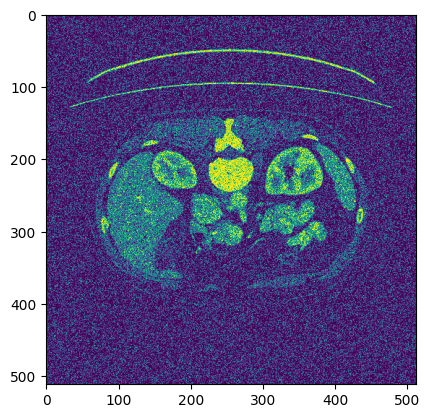

In [28]:
plt.imshow(noise_training_dataset[2])  #to show the noise_training_dataset images of index 2

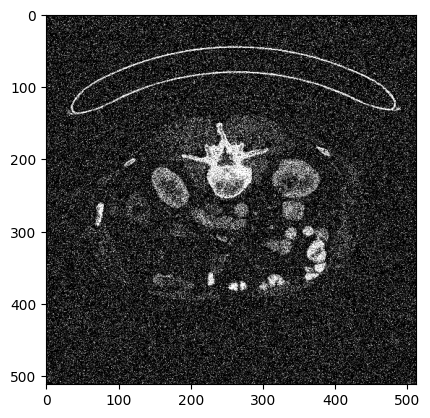

In [29]:
plt.imshow(noise_test_dataset[2], cmap='gray')      #to show the noise_test-dataset images of index 2

##Let's take a look into more in noise grayscale images

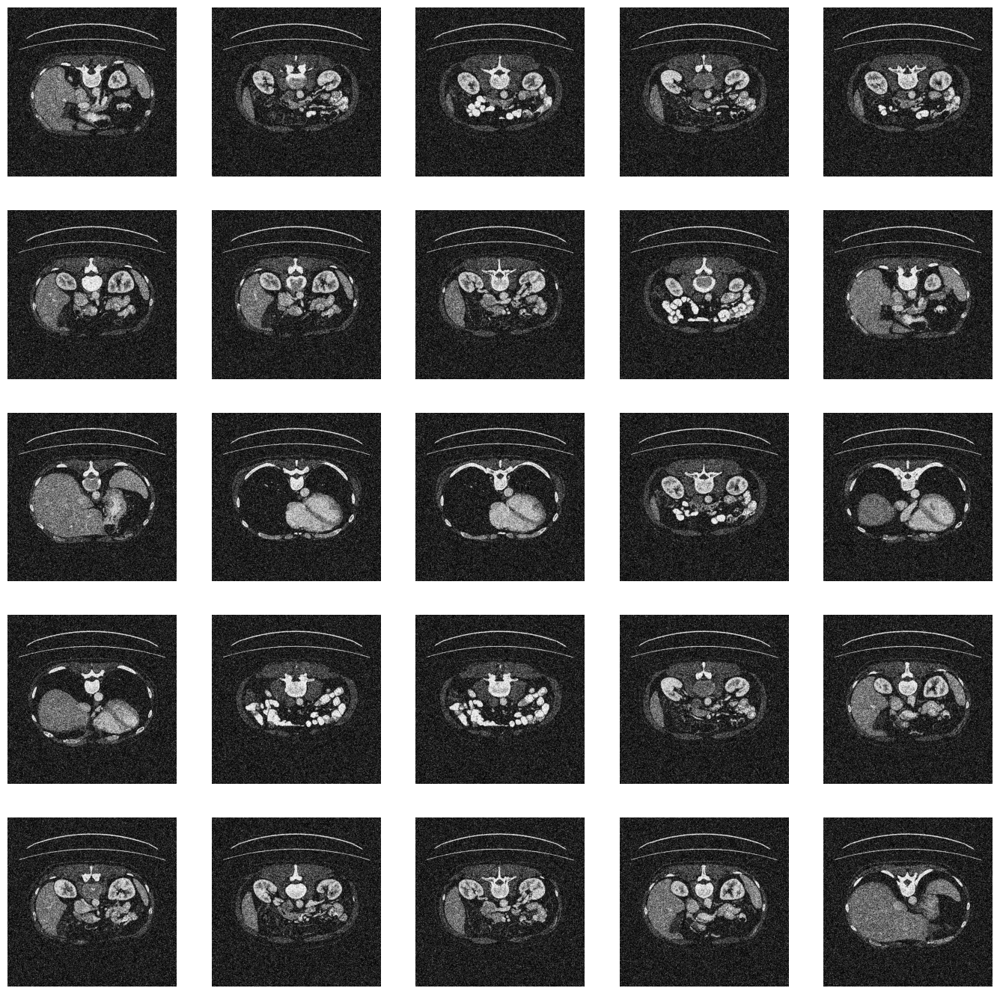

In [30]:
l_grid=5
w_grid=5
fig,axes=plt.subplots(l_grid,w_grid,figsize=(17,17))
axes=axes.ravel()
for i in range(l_grid*w_grid):
  index=np.random.randint(0,len(noise_training_dataset))
  axes[i].imshow(noise_training_dataset[index],cmap='gray')
  axes[i].set_axis_off()

## Finally we reach to building the autoencoders
we will build the model using keras library and with some predefined autoencoders and we will see result on each autoencoders in the form of our  prediction

####First we gonna import some import libraries in order to create our model

In [31]:
import tensorflow as tf #google framework to build DL and ML model
import keras
from keras.models import Model
from keras.optimizers import Adadelta
from keras.layers import Input, Conv2D, MaxPool2D, UpSampling2D,Conv2DTranspose
from keras.callbacks import History

###Here is the sequential Model of autoencoder that I have made with keras library using tensorflow

## The Sequential model, which is very straightforward (a simple list of layers), but is limited to single-input, single-output stacks of layers (as the name gives away).

####Layers are the basic building blocks of neural networks in Keras. A layer consists of a tensor-in tensor-out computation function (the layer's call method) and some state, held in TensorFlow variables (the layer's weights).


##2D convolution layer (e.g. spatial convolution over images).

This layer creates a convolution kernel that is convolved with the layer input to produce a tensor of outputs. If use_bias is True, a bias vector is created and added to the outputs. Finally, if activation is not None, it is applied to the outputs as well.

When using this layer as the first layer in a model, provide the keyword argument input_shape (tuple of integers, does not include the sample axis), e.g. input_shape=(128, 128, 3) for 128x128 RGB pictures in data_format="channels_last".

In [32]:
autoencoder = tf.keras.models.Sequential()
#encoder
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1,activation='relu', padding = 'same', input_shape = (512,512,1)))
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1, activation='relu',padding='same'))
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1, activation='relu', padding = 'same'))
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1, activation='relu', padding = 'same'))
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1, activation='relu', padding = 'same'))
autoencoder.add(tf.keras.layers.Conv2D(filters=15, kernel_size = 5, strides = 1, activation='relu'))
#decoder
autoencoder.add(tf.keras.layers.Conv2DTranspose(filters=15, kernel_size = 5, strides = 1, activation='relu'))
autoencoder.add(tf.keras.layers.Conv2DTranspose(filters=15, kernel_size = 5, strides = 1, activation='relu', padding = 'same'))
autoencoder.add(tf.keras.layers.Conv2DTranspose(filters=15, kernel_size = 5, strides= 1, activation='relu', padding='same'))
autoencoder.add(tf.keras.layers.Conv2DTranspose(filters=15, kernel_size = 5, strides = 1, activation = 'relu', padding = 'same'))
autoencoder.add(tf.keras.layers.Conv2DTranspose(filters=1, kernel_size = 5, strides = 1, activation = 'relu', padding = 'same'))

##We will see the number of parameters our model is generatint to train and validate our data
###We will compile and see the summary of the model

In [33]:
autoencoder.compile(loss= 'binary_crossentropy', optimizer= tf.keras.optimizers.Adam(lr=0.001), metrics =['accuracy'])
autoencoder.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 512, 512, 15)      390       
                                                                 
 conv2d_1 (Conv2D)           (None, 512, 512, 15)      5640      
                                                                 
 conv2d_2 (Conv2D)           (None, 512, 512, 15)      5640      
                                                                 
 conv2d_3 (Conv2D)           (None, 512, 512, 15)      5640      
                                                                 
 conv2d_4 (Conv2D)           (None, 512, 512, 15)      5640      
                                                                 
 conv2d_5 (Conv2D)           (None, 508, 508, 15)      5640      
                                                                 
 conv2d_transpose (Conv2DTra  (None, 512, 512, 15)     5

##The is the very important step in this step we do  Normalisation and sqeeze our dataset dimension  so that we will make it for fitting

In [34]:
noise_training_dataset=noise_training_dataset.squeeze()
noise_test_dataset=noise_test_dataset.squeeze()
img_training_dataset=img_training_dataset.squeeze()
img_testing_dataset=img_testing_dataset.squeeze()
img_training_dataset=np.expand_dims(img_training_dataset,axis=3)
img_testing_dataset=np.expand_dims(img_testing_dataset,axis=3)
noise_training_dataset = np.expand_dims(noise_training_dataset,axis =3)
noise_test_dataset = np.expand_dims(noise_test_dataset,axis= 3)
print(img_training_dataset.shape)

(196, 512, 512, 1)


#Lets fit out Model and check it through the accuracy matrics
we will run our model on 10 epochs, 10 batch_size and train 196 datapoint and validate on 22 datapoint

###keras.fit() in Python is a deep learning libraries which can be used to train our machine learning and deep learning models.

Keras.fit()

In [35]:
autoencoder.fit( noise_training_dataset
                ,img_training_dataset,
                 epochs=10,
                 batch_size=10,
                shuffle='True',
                validation_data=(noise_test_dataset,
                                 img_testing_dataset
                                 )
                   )

Epoch 1/10
20/20 [==============================] - 34s 713ms/step - loss: 0.3934 - accuracy: 0.7779 - val_loss: 0.2329 - val_accuracy: 0.8090
Epoch 2/10
20/20 [==============================] - 11s 531ms/step - loss: 0.3103 - accuracy: 0.7779 - val_loss: 0.2347 - val_accuracy: 0.8090
Epoch 3/10
20/20 [==============================] - 11s 534ms/step - loss: 0.3099 - accuracy: 0.7779 - val_loss: 0.2358 - val_accuracy: 0.8090
Epoch 4/10
20/20 [==============================] - 11s 552ms/step - loss: 0.3089 - accuracy: 0.7779 - val_loss: 0.2304 - val_accuracy: 0.8090
Epoch 5/10
20/20 [==============================] - 11s 555ms/step - loss: 0.2980 - accuracy: 0.7779 - val_loss: 0.2257 - val_accuracy: 0.8090
Epoch 6/10
20/20 [==============================] - 11s 543ms/step - loss: 0.2553 - accuracy: 0.7791 - val_loss: 0.1652 - val_accuracy: 0.8154
Epoch 7/10
20/20 [==============================] - 11s 561ms/step - loss: 0.1728 - accuracy: 0.7875 - val_loss: 0.1324 - val_accuracy: 0.8153

#Lets evalute this model

In [36]:
evaluation = autoencoder.evaluate(noise_test_dataset, img_testing_dataset) #evalutation to see the model performance
#print('testaccuracy :{:.3f}'.format(evaluation))


1/1 [==============================] - 5s 5s/step - loss: 0.1204 - accuracy: 0.8161


Now its time to predict our model and we will see the result

In [37]:
predicted = autoencoder.predict(noise_test_dataset[:10])

1/1 [==============================] - 0s 281ms/step


Lets see the result of  prediction

<ipython-input-38-f2a6f9f7bf67>:18: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_value = psnr(img_noise, img_denoised)


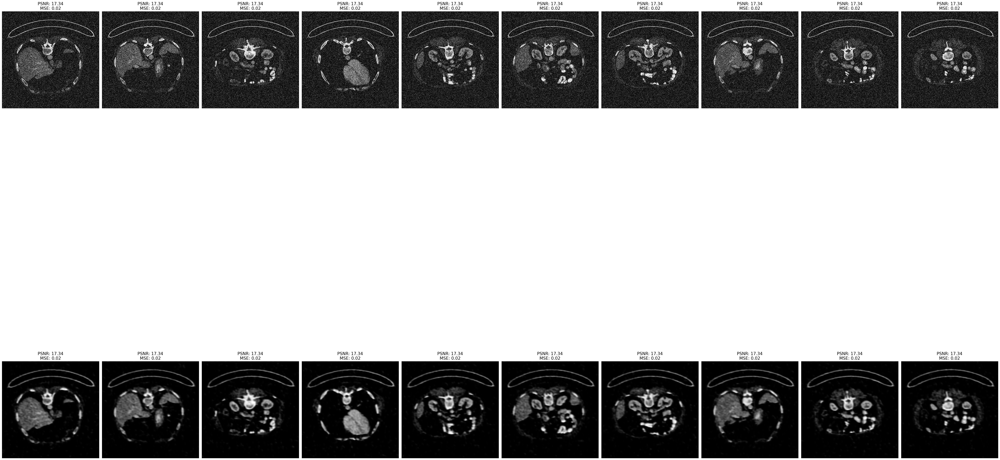

In [38]:
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import mean_squared_error as mse

fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(50, 50))

for images, row in zip([noise_test_dataset[:10], predicted], axes):
    for img, ax in zip(images, row):
        img = img.squeeze()
        ax.imshow(img, cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Calcola PSNR e MSE tra l'immagine noise (rumorosa) e quella denoised (ripulita)
        img_noise = noise_test_dataset[0]  # Immagine rumorosa
        img_denoised = predicted[0]  # Immagine denoised

        psnr_value = psnr(img_noise, img_denoised)
        mse_value = mse(img_noise, img_denoised)

        # Aggiungi i valori di PSNR e MSE come titoli delle immagini con testo più grande
        ax.set_title(f"PSNR: {psnr_value:.2f}\nMSE: {mse_value:.2f}", fontsize=15)

fig.subplots_adjust(wspace=0, hspace=0)  # Rimuove gli spazi tra le immagini
plt.tight_layout()  # Ottimizza il layout per evitare sovrapposizioni
plt.show()


###As you have seen above the result of what our autoencoders does it clean out images but it get some blurry this is the problem that occurs in autoencoder we have already talked about it



## For learning purpose, I am showing results of two more autoencoders
These two autoencoder are taken from keras and result are not good with my dataset

## convolutional autoencoder
Since our inputs are images, it makes sense to use convolutional neural networks (convnets) as encoders and decoders
Let's implement one. The encoder will consist in a stack of Conv2D and MaxPooling2D layers (max pooling being used for spatial down-sampling), while the decoder will consist in a stack of Conv2D and UpSampling2D layers.

In [39]:
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D
from keras.models import Model
from keras import backend as K

input_img = Input(shape=(512, 512, 1)) # adapt this if using `channels_first` image data format
#Encoder

x = Conv2D(16, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)
#Decoder
x = Conv2D(8, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy')

In [40]:
autoencoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 512, 512, 1)]     0         
                                                                 
 conv2d_6 (Conv2D)           (None, 512, 512, 16)      160       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 256, 256, 16)     0         
 )                                                               
                                                                 
 conv2d_7 (Conv2D)           (None, 256, 256, 8)       1160      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 128, 128, 8)      0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 128, 128, 8)       584   

In [41]:
from keras.callbacks import TensorBoard

autoencoder.fit( noise_training_dataset
                ,img_training_dataset,
                epochs=100,
                batch_size=100,
                shuffle=True,
                validation_data=(noise_test_dataset,
                                 img_testing_dataset),
                callbacks=[TensorBoard(log_dir='/tmp/tb', histogram_freq=0, write_graph=True)])

Epoch 1/100
2/2 [==============================] - 29s 12s/step - loss: 0.6931 - val_loss: 0.6931
Epoch 2/100
2/2 [==============================] - 1s 630ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 3/100
2/2 [==============================] - 1s 728ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 4/100
2/2 [==============================] - 1s 641ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 5/100
2/2 [==============================] - 1s 776ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 6/100
2/2 [==============================] - 1s 621ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 7/100
2/2 [==============================] - 1s 629ms/step - loss: 0.6931 - val_loss: 0.6931
Epoch 8/100
2/2 [==============================] - 1s 628ms/step - loss: 0.6931 - val_loss: 0.6930
Epoch 9/100
2/2 [==============================] - 1s 651ms/step - loss: 0.6930 - val_loss: 0.6930
Epoch 10/100
2/2 [==============================] - 1s 661ms/step - loss: 0.6930 - val_loss: 0.6930
Epoch 11/1

## Evaluate the Model

In [42]:
evaluation = autoencoder.evaluate(noise_test_dataset, img_testing_dataset) #evalutation to see the model performance

1/1 [==============================] - 0s 106ms/step - loss: 0.6913


## Predict the model

In [43]:
predicted = autoencoder.predict(noise_test_dataset[:10])

1/1 [==============================] - 1s 1s/step


## Predicted result

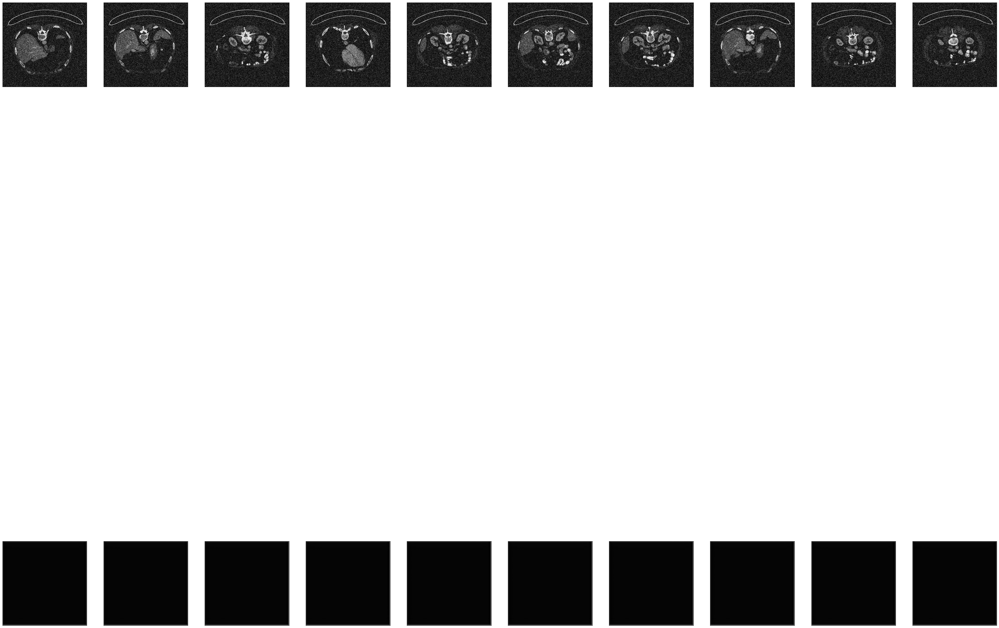

In [44]:
fig, axes = plt.subplots(nrows = 2, ncols = 10, sharex=True, sharey=True , figsize =  (50,50))
for images, row in zip([noise_test_dataset[:10],predicted],axes):
  for img,  ax in zip(images,row):
    img=img.squeeze()
    ax.imshow(img, cmap='gray' )
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

#Deep autoencoder

In [45]:
input_img = Input(shape=(512,512,1))
encoded = Dense(256, activation='relu')(input_img)
encoded = Dense(128, activation='relu')(encoded)
encoded = Dense(64, activation='relu')(encoded)
encoded = Dense(32, activation='relu')(encoded)
encoded = Dense(16, activation='relu')(encoded)
decoded = Dense(32, activation='relu')(encoded)
decoded = Dense(64, activation='relu')(decoded)
decoded = Dense(128, activation='relu')(encoded)
decoded = Dense(256, activation='relu')(decoded)
decoded = Dense(1, activation='sigmoid')(decoded)

In [46]:
autoencoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 512, 512, 1)]     0         
                                                                 
 conv2d_6 (Conv2D)           (None, 512, 512, 16)      160       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 256, 256, 16)     0         
 )                                                               
                                                                 
 conv2d_7 (Conv2D)           (None, 256, 256, 8)       1160      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 128, 128, 8)      0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 128, 128, 8)       584   

##Compile and Fit the Model

In [47]:
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy', metrics = ['accuracy'])

autoencoder.fit( noise_training_dataset
                ,img_training_dataset,
                epochs=5,
                batch_size=5,
                shuffle=True,
                validation_data=(noise_test_dataset,
                                 img_testing_dataset))

Epoch 1/5
40/40 [==============================] - 26s 565ms/step - loss: 0.6930 - accuracy: 0.7779 - val_loss: 0.6927 - val_accuracy: 0.8090
Epoch 2/5
40/40 [==============================] - 22s 553ms/step - loss: 0.6925 - accuracy: 0.7779 - val_loss: 0.6922 - val_accuracy: 0.8090
Epoch 3/5
40/40 [==============================] - 22s 556ms/step - loss: 0.6921 - accuracy: 0.7779 - val_loss: 0.6918 - val_accuracy: 0.8090
Epoch 4/5
40/40 [==============================] - 22s 563ms/step - loss: 0.6917 - accuracy: 0.7779 - val_loss: 0.6913 - val_accuracy: 0.8090
Epoch 5/5
40/40 [==============================] - 23s 566ms/step - loss: 0.6912 - accuracy: 0.7779 - val_loss: 0.6908 - val_accuracy: 0.8090


##Predict the Model

In [48]:
predicted = autoencoder.predict(noise_test_dataset[:10])

1/1 [==============================] - 1s 722ms/step


##Predicted Result

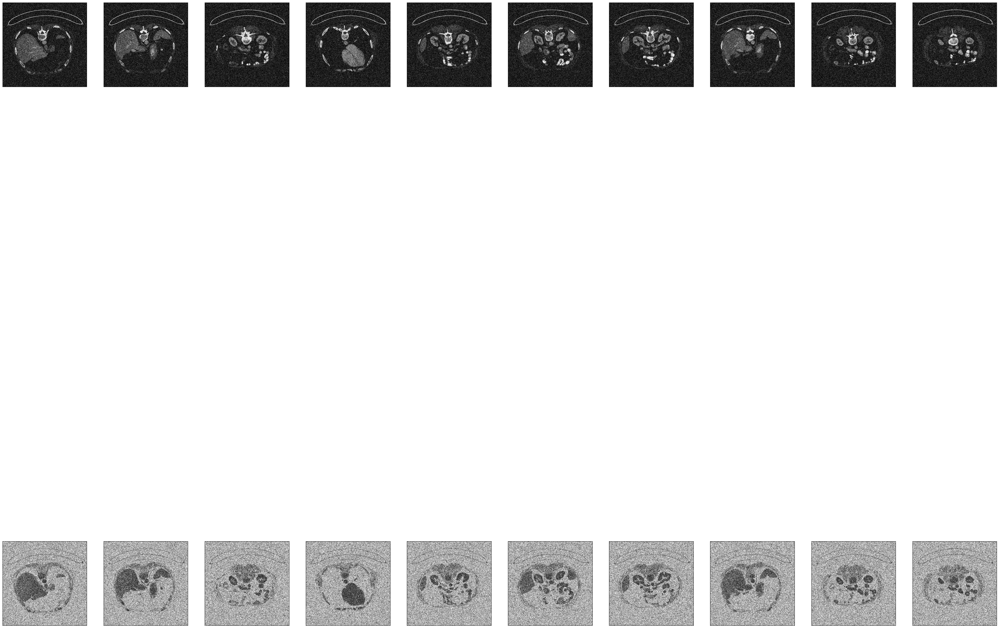

In [49]:
fig, axes = plt.subplots(nrows = 2, ncols = 10, sharex=True, sharey=True , figsize =  (50,50))
for images, row in zip([noise_test_dataset[:10],predicted],axes):
  for img,  ax in zip(images,row):
    img=img.squeeze()
    ax.imshow(img, cmap='gray' )
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)